# IEEE-CIS Fraud Detection
## EDA on transaction data
*Visit [kaggle](https://www.kaggle.com/c/ieee-fraud-detection) for competition details*

**Authored by Soyoung Kang**

## DataFrames and Variables
- trns_train: whole dataframe
- trns_card: merged columns card1~card6 into 'card_merged', dropped card1~card6, dropped V's
- trns_fraud: trns_train, isFraud == 1
- trns_nonfraud: trns_train, isFraud == 0
- trns_card_fraud: trns_card, isFraud == 1
- trns_card_nonfraud: trns_card, isFraud == 0
- trns_card_fraud_dup: repeated rows with identical ('TransactionAmt', 'ProductCD', 'card_merged')  


- net_fraud_amt: TransactionAmts that only appear in fraud transactions
- net_nonfraud_amt: TransactionAmts that only appear in nonfraud transactions

In [1]:
import pandas as pd
import pandas_profiling as pp
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings("ignore")

pd.set_option('display.max_columns', 500)
pd.set_option('display.max_rows', 500)

In [2]:
trns_train = pd.read_csv('../ieee-fraud-detection/train_transaction.csv', engine = 'python')
trns_train.head(10)

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,dist1,dist2,P_emaildomain,R_emaildomain,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
0,2987000,0,86400,68.5,W,13926,NaN,150.0,discover,142.0,credit,315.0,87.0,19.0,NaN,NaN,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,0.0,1.0,1.0,14.0,NaN,13.0,NaN,NaN,NaN,NaN,NaN,NaN,13.0,13.0,NaN,NaN,NaN,0.0,T,T,T,M2,F,T,NaN,NaN,NaN,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,117.0,0.0,0.0,0.0,0.0,0.0,117.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,117.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,117.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2987001,0,86401,29.0,W,2755,404.0,150.0,mastercard,102.0,credit,325.0,87.0,NaN,NaN,gmail.com,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,M0,T,T,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,

In [3]:
trns_train.shape

(590540, 394)

In [4]:
list(trns_train.columns)

['TransactionID',
 'isFraud',
 'TransactionDT',
 'TransactionAmt',
 'ProductCD',
 'card1',
 'card2',
 'card3',
 'card4',
 'card5',
 'card6',
 'addr1',
 'addr2',
 'dist1',
 'dist2',
 'P_emaildomain',
 'R_emaildomain',
 'C1',
 'C2',
 'C3',
 'C4',
 'C5',
 'C6',
 'C7',
 'C8',
 'C9',
 'C10',
 'C11',
 'C12',
 'C13',
 'C14',
 'D1',
 'D2',
 'D3',
 'D4',
 'D5',
 'D6',
 'D7',
 'D8',
 'D9',
 'D10',
 'D11',
 'D12',
 'D13',
 'D14',
 'D15',
 'M1',
 'M2',
 'M3',
 'M4',
 'M5',
 'M6',
 'M7',
 'M8',
 'M9',
 'V1',
 'V2',
 'V3',
 'V4',
 'V5',
 'V6',
 'V7',
 'V8',
 'V9',
 'V10',
 'V11',
 'V12',
 'V13',
 'V14',
 'V15',
 'V16',
 'V17',
 'V18',
 'V19',
 'V20',
 'V21',
 'V22',
 'V23',
 'V24',
 'V25',
 'V26',
 'V27',
 'V28',
 'V29',
 'V30',
 'V31',
 'V32',
 'V33',
 'V34',
 'V35',
 'V36',
 'V37',
 'V38',
 'V39',
 'V40',
 'V41',
 'V42',
 'V43',
 'V44',
 'V45',
 'V46',
 'V47',
 'V48',
 'V49',
 'V50',
 'V51',
 'V52',
 'V53',
 'V54',
 'V55',
 'V56',
 'V57',
 'V58',
 'V59',
 'V60',
 'V61',
 'V62',
 'V63',
 'V64',
 'V

In [5]:
trns_train.isnull().sum()

TransactionID          0
isFraud                0
TransactionDT          0
TransactionAmt         0
ProductCD              0
card1                  0
card2               8933
card3               1565
card4               1577
card5               4259
card6               1571
addr1              65706
addr2              65706
dist1             352271
dist2             552913
P_emaildomain      94456
R_emaildomain     453249
C1                     0
C2                     0
C3                     0
C4                     0
C5                     0
C6                     0
C7                     0
C8                     0
C9                     0
C10                    0
C11                    0
C12                    0
C13                    0
C14                    0
D1                  1269
D2                280797
D3                262878
D4                168922
D5                309841
D6                517353
D7                551623
D8                515614
D9                515614


In [12]:
# Merge columns card1~card6

trns_train['card_merged'] = trns_train[['card1', 'card2', 'card3', 'card4', 'card5', 'card6']].astype(str).apply(lambda x : ' '.join(x), axis = 1)
col = trns_train.columns.tolist()
col = col[:5] + col[-1:] + col[11:55]
col

trns_card = trns_train[col]
trns_card.head(10)

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card_merged,addr1,addr2,dist1,dist2,P_emaildomain,R_emaildomain,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9
0,2987000,0,86400,68.5,W,13926 nan 150.0 discover 142.0 credit,315.0,87.0,19.0,NaN,NaN,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,0.0,1.0,1.0,14.0,NaN,13.0,NaN,NaN,NaN,NaN,NaN,NaN,13.0,13.0,NaN,NaN,NaN,0.0,T,T,T,M2,F,T,NaN,NaN,NaN
1,2987001,0,86401,29.0,W,2755 404.0 150.0 mastercard 102.0 credit,325.0,87.0,NaN,NaN,gmail.com,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,M0,T,T,NaN,NaN,NaN
2,2987002,0,86469,59.0,W,4663 490.0 150.0 visa 166.0 debit,330.0,87.0,287.0,NaN,outlook.com,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,315.0,NaN,NaN,NaN,315.0,T,T,T,M0,F,F,F,F,F
3,2987003,0,86499,50.0,W,18132 567.0 150.0 mastercard 117.0 debit,476.0,87.0,NaN,NaN,yahoo.com,NaN,2.0,5.0,0.0,0.0,0.0,4.0,0.0,0.0,1.0,0.0,1.0,0.0,25.0,1.0,112.0,112.0,0.0,94.0,0.0,NaN,NaN,NaN,NaN,84.0,NaN,NaN,NaN,NaN,111.0,NaN,NaN,NaN,M0,T,F,NaN,NaN,NaN
4,2987004,0,86506,50.0,H,4497 514.0 150.0 mastercard 102.0 credit,420.0,87.0,NaN,NaN,gmail.com,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,2987005,0,86510,49.0,W,5937 555.0 150.0 visa 226.0 debit,272.0,87.0,36.0,NaN,gmail.com,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,0.0,T,T,T,M1,F,T,NaN,NaN,NaN
6,2987006,0,86522,159.0,W,12308 360.0 150.0 visa 166.0 debit,126.0,87.0,0.0,NaN,yahoo.com,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,0.0,T,T,T,M0,F,F,T,T,T
7,2987007,0,86529,422.5,W,12695 490.0 150.0 visa 226.0 debit,325.0,87.0,NaN,NaN,mail.com,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,M0,F,F,NaN,NaN,NaN
8,2987008,0,86535,15.0,H,2803 100.0 150.0 visa 226.0 debit,337.0,87.0,NaN,NaN,anonymous.com,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,2987009,0,86536,117.0,W,17399 111.0 150.0 mastercard 224.0 debit,204.0,87.0,19.0,NaN,yahoo.com,NaN,2.0,2.0,0.0,0.0,0.0,3.0,0.0,0.0,3.0,0.0,1.0,0.0,12.0,2.0,61.0,61.0,30.0,318.0,30.0,NaN,NaN,NaN,NaN,40.0,302.0,NaN,NaN,NaN,318.0,T,T,T,M0,T,T,NaN,NaN,NaN


# 1. Categorical Variables

In [14]:
# Convert the datatype 'object' to 'category' for sake of speed

tlst = list(trns_train.select_dtypes(include = 'object').columns)
clst = list(trns_card.select_dtypes(include = 'object').columns)

for t in tlst:
    trns_train[c] = trns_train[c].astype('category')

for c in clst:
    trns_card[c] = trns_card[c].astype('category')

In [135]:
trns_train.select_dtypes(include = 'category').head(10)

,ProductCD,card4,card6,P_emaildomain,R_emaildomain,M1,M2,M3,M4,M5,M6,M7,M8,M9,card_merged
0,W,discover,credit,NaN,NaN,T,T,T,M2,F,T,NaN,NaN,NaN,13926 nan 150.0 discover 142.0 credit
1,W,mastercard,credit,gmail.com,NaN,NaN,NaN,NaN,M0,T,T,NaN,NaN,NaN,2755 404.0 150.0 mastercard 102.0 credit
2,W,visa,debit,outlook.com,NaN,T,T,T,M0,F,F,F,F,F,4663 490.0 150.0 visa 166.0 debit
3,W,mastercard,debit,yahoo.com,NaN,NaN,NaN,NaN,M0,T,F,NaN,NaN,NaN,18132 567.0 150.0 mastercard 117.0 debit
4,H,mastercard,credit,gmail.com,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4497 514.0 150.0 mastercard 102.0 credit
5,W,visa,debit,gmail.com,NaN,T,T,T,M1,F,T,NaN,NaN,NaN,5937 555.0 150.0 visa 226.0 debit
6,W,visa,debit,yahoo.com,NaN,T,T,T,M0,F,F,T,T,T,12308 360.0 150.0 visa 166.0 debit
7,W,visa,debit,mail.com,NaN,NaN,NaN,NaN,M0,F,F,NaN,NaN,NaN,12695 490.0 150.0 visa 226.0 debit
8,H,visa,debit,anonymous.com,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2803 100.0 150.0 visa 226.0 debit
9,W,mastercard,debit,yahoo.com,NaN,T,T,T,M0,T,T,NaN,NaN,NaN,17399 111.0 150.0 mastercard 224.0 debit


In [15]:
trns_fraud = trns_train[trns_train.isFraud == 1]
trns_nonfraud = trns_train[trns_train.isFraud == 0]

trns_card_fraud = trns_card[trns_card.isFraud == 1]
trns_card_nonfraud = trns_card[trns_card.isFraud == 0]

In [34]:
trns_nonfraud.shape

(569877, 394)

## Checking null values on categorical variables

In [9]:
trns_train.select_dtypes('category').isnull().sum()

ProductCD             0
card4              1577
card6              1571
P_emaildomain     94456
R_emaildomain    453249
M1               271100
M2               271100
M3               271100
M4               281444
M5               350482
M6               169360
M7               346265
M8               346252
M9               346252
dtype: int64

## Overall description on categorical variables

### Whole data

In [10]:
trns_train.describe(include=['category'])

,ProductCD,card4,card6,P_emaildomain,R_emaildomain,M1,M2,M3,M4,M5,M6,M7,M8,M9
count,590540,588963,588969,496084,137291,319440,319440,319440,309096,240058,421180,244275,244288,244288
unique,5,4,4,59,60,2,2,2,3,2,2,2,2,2
top,W,visa,debit,gmail.com,gmail.com,T,T,T,M0,F,F,F,F,T
freq,439670,384767,439938,228355,57147,319415,285468,251731,196405,132491,227856,211374,155251,205656


### Fraud data

In [11]:
trns_fraud.describe(include=['category'])

,ProductCD,card4,card6,P_emaildomain,R_emaildomain,M1,M2,M3,M4,M5,M6,M7,M8,M9
count,20663,20622,20624,17873,11227,6342,6342,6342,15436,7569,8692,4817,4817,4817
unique,5,4,2,42,32,1,2,2,3,2,2,2,2,2
top,W,visa,debit,gmail.com,gmail.com,T,T,T,M0,T,F,F,F,T
freq,8969,13373,10674,9943,6811,6342,5158,4293,7198,4055,5397,4089,3373,3658


### NonFraud data

In [12]:
trns_nonfraud.describe(include=['category'])

,ProductCD,card4,card6,P_emaildomain,R_emaildomain,M1,M2,M3,M4,M5,M6,M7,M8,M9
count,569877,568341,568345,478211,126064,313098,313098,313098,293660,232489,412488,239458,239471,239471
unique,5,4,4,59,60,2,2,2,3,2,2,2,2,2
top,W,visa,debit,gmail.com,gmail.com,T,T,T,M0,F,F,F,F,T
freq,430701,371394,429264,218412,50336,313073,280310,247438,189207,128977,222459,207285,151878,201998


## A. ProductCD (Product code)

### Number of fraud transactions and total TransactionAmt per category

In [216]:
s0 = trns_train.groupby('ProductCD')['isFraud'].count()
s1 = trns_train.groupby('ProductCD')['isFraud'].sum()
s2 = trns_train.groupby('ProductCD')['isFraud'].sum() / trns_train.groupby('ProductCD')['isFraud'].count()
s3 = trns_train.groupby('ProductCD')['TransactionAmt'].sum()
s4 = trns_fraud.groupby('ProductCD')['TransactionAmt'].sum()
s5 = trns_fraud.groupby('ProductCD')['TransactionAmt'].sum() / trns_train.groupby('ProductCD')['TransactionAmt'].sum()

df = pd.DataFrame(columns = ['transaction_num', 'fraud_num', 'fraud_ratio', 'total_amt', 'fraud_amt', 'fraud_amt_ratio'])
df['transaction_num'] = s0
df['fraud_num'] = s1
df['fraud_ratio'] = s2
df['total_amt'] = s3
df['fraud_amt'] = s4
df['fraud_amt_ratio'] = s5
df

,transaction_num,fraud_num,fraud_ratio,total_amt,fraud_amt,fraud_amt_ratio
ProductCD,,,,,,
C,68519,8008,0.116873,2.937571e+06,391421.40,0.133247
H,33024,1574,0.047662,2.416368e+06,246632.00,0.102067
R,37699,1426,0.037826,6.344975e+06,348050.00,0.054854
S,11628,686,0.058996,7.008136e+05,43416.00,0.061951
W,439670,8969,0.020399,6.733922e+07,2054325.46,0.030507


In [219]:
d1 = {'C': 0.116873, 'H': 0.047662, 'R': 0.037826, 'S': 0.058996, 'W': 0.020399}
d2 = {'C': 0.133247, 'H': 0.102067, 'R': 0.054854, 'S': 0.061951, 'W': 0.030507}

trns_train['fraud_ratio'] = trns_train['ProductCD'].map(d1)
trns_train['fraud_amt_ratio'] = trns_train['ProductCD'].map(d2)

In [220]:
trns_train.head()

,TransactionID,isFraud,TransactionDT,TransactionAmt,TransactionAmt_residue,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,dist1,dist2,P_emaildomain,R_emaildomain,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,card_merged,fraud_ratio,fraud_amt_ratio
0,2987000,0,86400,68.5,0,W,13926,NaN,150.0,discover,142.0,credit,315.0,87.0,19.0,NaN,NaN,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,0.0,1.0,1.0,14.0,NaN,13.0,NaN,NaN,NaN,NaN,NaN,NaN,13.0,13.0,NaN,NaN,NaN,0.0,T,T,T,M2,F,T,NaN,NaN,NaN,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,117.0,0.0,0.0,0.0,0.0,0.0,117.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,117.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,117.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13926 nan 150.0 discover 142.0 credit,0.020399,0.030507
1,2987001,0,86401,29.0,0,W,2755,404.0,150.0,mastercard,102.0,credit,325.0,87.0,NaN,NaN,gmail.com,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,M0,T,T,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0

### Profiling

In [222]:
pcd = trns_train[['isFraud', 'fraud_amt_ratio']]
pp.ProfileReport(pcd)

## B. card1

### Categories

In [227]:
len(trns_train.card1.unique())

13553

### Profiling

In [239]:
c1 = trns_train[['isFraud', 'card1']]
pp.ProfileReport(c1)

## C. card2

### Categories

In [237]:
card2 = trns_train.card2.unique()
#card2

In [231]:
trns_dum = pd.get_dummies(trns_train, dummy_na = True, columns = ['card2'])
trns_dum.head()

,TransactionID,isFraud,TransactionDT,TransactionAmt,TransactionAmt_residue,ProductCD,card1,card3,card4,card5,card6,addr1,addr2,dist1,dist2,P_emaildomain,R_emaildomain,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,...,card2_352.0,card2_353.0,card2_354.0,card2_355.0,card2_356.0,card2_357.0,card2_358.0,card2_359.0,card2_360.0,card2_361.0,card2_362.0,card2_363.0,card2_364.0,card2_365.0,card2_366.0,card2_367.0,card2_368.0,card2_369.0,card2_370.0,card2_371.0,card2_372.0,card2_373.0,card2_374.0,card2_375.0,card2_376.0,card2_377.0,card2_378.0,card2_379.0,card2_380.0,card2_381.0,card2_382.0,card2_383.0,card2_384.0,card2_385.0,card2_386.0,card2_387.0,card2_388.0,card2_389.0,card2_390.0,card2_391.0,card2_392.0,card2_393.0,card2_394.0,card2_395.0,card2_396.0,card2_397.0,card2_398.0,card2_399.0,card2_400.0,card2_401.0,card2_402.0,card2_403.0,card2_404.0,card2_405.0,card2_406.0,card2_407.0,card2_408.0,card2_409.0,card2_410.0,card2_411.0,card2_412.0,card2_413.0,card2_414.0,card2_415.0,card2_416.0,card2_417.0,card2_418.0,card2_419.0,card2_420.0,card2_421.0,card2_422.0,card2_423.0,card2_424.0,card2_425.0,card2_426.0,card2_427.0,card2_428.0,card2_429.0,card2_430.0,card2_431.0,card2_432.0,card2_433.0,card2_434.0,card2_435.0,card2_436.0,card2_437.0,card2_438.0,card2_439.0,card2_440.0,card2_441.0,card2_442.0,card2_443.0,card2_444.0,card2_445.0,card2_446.0,card2_447.0,card2_448.0,card2_449.0,card2_450.0,card2_451.0,card2_452.0,card2_453.0,card2_454.0,card2_455.0,card2_456.0,card2_457.0,card2_458.0,card2_459.0,card2_460.0,card2_461.0,card2_462.0,card2_463.0,card2_464.0,card2_465.0,card2_466.0,card2_467.0,card2_468.0,card2_469.0,card2_470.0,card2_471.0,card2_472.0,card2_473.0,card2_474.0,card2_475.0,card2_476.0,card2_477.0,card2_478.0,card2_479.0,card2_480.0,card2_481.0,card2_482.0,card2_483.0,card2_484.0,card2_485.0,card2_486.0,card2_487.0,card2_488.0,card2_489.0,card2_490.0,card2_491.0,card2_492.0,card2_493.0,card2_494.0,card2_495.0,card2_496.0,card2_497.0,card2_498.0,card2_499.0,card2_500.0,card2_501.0,card2_502.0,card2_503.0,card2_504.0,card2_505.0,card2_506.0,card2_507.0,card2_508.0,card2_509.0,card2_510.0,card2_511.0,card2_512.0,card2_513.0,card2_514.0,card2_515.0,card2_516.0,card2_517.0,card2_518.0,card2_519.0,card2_520.0,card2_521.0,card2_522.0,card2_523.0,card2_524.0,card2_525.0,card2_526.0,card2_527.0,card2_528.0,card2_529.0,card2_530.0,card2_531.0,card2_532.0,card2_533.0,card2_534.0,card2_535.0,card2_536.0,card2_537.0,card2_538.0,card2_539.0,card2_540.0,card2_541.0,card2_542.0,card2_543.0,card2_544.0,card2_545.0,card2_546.0,card2_547.0,card2_548.0,card2_549.0,card2_550.0,card2_551.0,card2_552.0,card2_553.0,card2_554.0,card2_555.0,card2_556.0,card2_557.0,card2_558.0,card2_559.0,card2_560.0,card2_561.0,card2_562.0,card2_563.0,card2_564.0,card2_565.0,card2_566.0,card2_567.0,card2_568.0,card2_569.0,card2_570.0,card2_571.0,card2_572.0,card2_573.0,card2_574.0,card2_575.0,card2_576.0,card2_577.0,card2_578.0,card2_579.0,card2_580.0,card2_581.0,card2_582.0,card2_583.0,card2_584.0,card2_585.0,card2_586.0,card2_587.0,card2

### Profiling

In [229]:
c2 = trns_train[['isFraud', 'card2']]
pp.ProfileReport(c2)

## D. card3

### Categories

In [241]:
len(trns_train.card3.unique())

115

### Profiling

In [242]:
c3 = trns_train[['isFraud', 'card3']]
pp.ProfileReport(c3)

## D. card4 (card network)

### Categories

In [15]:
trns_train.card4.unique()

[discover, mastercard, visa, american express, NaN]
Categories (4, object): [discover, mastercard, visa, american express]

### NaN values

In [243]:
trns_train[trns_train['card4'].isnull() == True].shape

(1577, 398)

### Correlation with isFraud

In [17]:
# Dummify card4

trns_dum = pd.get_dummies(data = trns_train, dummy_na = True)

In [18]:
trns_dum.filter(regex = '^card4_', axis = 1).corrwith(trns_dum['isFraud'])

card4_american express   -0.004095
card4_discover            0.024564
card4_mastercard         -0.002463
card4_visa               -0.001741
card4_nan                -0.002532
dtype: float64

### Profiling

In [244]:
c4 = trns_train[['isFraud', 'card4']]
pp.ProfileReport(c4)

## E. card5 (country?)

### Categories

In [257]:
c5_col = trns_train.card5.unique()

### NaN values

In [255]:
trns_train[trns_train['card5'].isnull() == True].head()

,TransactionID,isFraud,TransactionDT,TransactionAmt,TransactionAmt_residue,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,dist1,dist2,P_emaildomain,R_emaildomain,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,card_merged,fraud_ratio,fraud_amt_ratio
798,2987798,0,102655,108.500,0,W,17262,578.0,150.0,mastercard,NaN,credit,220.0,87.0,239.0,NaN,gmail.com,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,56.0,NaN,NaN,NaN,0.0,T,F,F,M0,T,F,NaN,NaN,NaN,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17262 578.0 150.0 mastercard nan credit,0.020399,0.030507
2540,2989540,0,147016,75.000,0,S,1357,555.0,150.0,american express,NaN,credit,226.0,87.0,NaN,2.0,NaN,anonymous.com,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,543.0,NaN,NaN,NaN,543.0,543.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1

### Number of fraud transactions and total TransactionAmt per category

In [248]:
s0 = trns_train.groupby(['card5'])['isFraud'].count()
s1 = trns_train.groupby(['card5'])['isFraud'].sum()
s2 = trns_train.groupby(['card5'])['isFraud'].sum() / trns_train.groupby(['card5'])['isFraud'].count()
s3 = trns_train.groupby(['card5'])['TransactionAmt'].sum()
s4 = trns_fraud.groupby('card5')['TransactionAmt'].sum()
s5 = trns_fraud.groupby('card5')['TransactionAmt'].sum() / trns_train.groupby(['card5'])['TransactionAmt'].sum()

df = pd.DataFrame(columns = ['transaction_num','fraud_num', 'fraud_ratio', 'total_amt', 'fraud_amt', 'fraud_amt_ratio'])
df['transaction_num'] = s0
df['fraud_num'] = s1
df['fraud_ratio'] = s2
df['total_amt'] = s3
df['fraud_amt'] = s4
df['fraud_amt_ratio'] = s5
df.sort_values(by = 'fraud_ratio', ascending = False)

,transaction_num,fraud_num,fraud_ratio,total_amt,fraud_amt,fraud_amt_ratio
card5,,,,,,
167.0,1,1,1.000000,1.000000e+02,100.000,1.000000
191.0,2,1,0.500000,3.150000e+02,300.000,0.952381
107.0,12,4,0.333333,1.750274e+03,892.000,0.509634
139.0,13,3,0.230769,5.109580e+02,173.613,0.339779
137.0,11720,1725,0.147184,8.460349e+05,101672.135,0.120175
212.0,42,5,0.119048,1.594408e+04,719.568,0.045131
147.0,417,47,0.112710,3.301083e+04,5159.986,0.156312
141.0,341,32,0.093842,8.712710e+04,4248.314,0.048760
143.0,43,4,0.093023,2.240220e+04,950.000,0.042407


In [258]:
df['fraud_ratio_level'] = ''
for index, row in df.iterrows():
    if row['fraud_ratio'] == 0:
        df['fraud_ratio_level'].set_value(index, 0)
    elif row['fraud_ratio'] < 0.05:
        df['fraud_ratio_level'].set_value(index, 1)
    elif row['fraud_ratio'] < 0.1:
        df['fraud_ratio_level'].set_value(index, 2)
    elif row['fraud_ratio'] < 0.2:
        df['fraud_ratio_level'].set_value(index, 3)
    elif row['fraud_ratio'] <= 0.5:
        df['fraud_ratio_level'].set_value(index, 4)
    else:
        df['fraud_ratio_level'].set_value(index, 5)

In [261]:
df_dic = df['fraud_ratio_level'].to_dict()
df_dic

{100.0: 1,
 101.0: 0,
 102.0: 2,
 104.0: 0,
 105.0: 0,
 106.0: 0,
 107.0: 4,
 109.0: 0,
 111.0: 0,
 112.0: 0,
 113.0: 0,
 114.0: 0,
 115.0: 0,
 116.0: 0,
 117.0: 1,
 118.0: 1,
 119.0: 1,
 120.0: 0,
 121.0: 0,
 122.0: 0,
 123.0: 0,
 125.0: 0,
 126.0: 1,
 127.0: 0,
 128.0: 0,
 129.0: 1,
 130.0: 0,
 131.0: 1,
 132.0: 1,
 133.0: 2,
 134.0: 1,
 135.0: 1,
 136.0: 0,
 137.0: 3,
 138.0: 2,
 139.0: 4,
 140.0: 0,
 141.0: 2,
 142.0: 1,
 143.0: 2,
 144.0: 2,
 145.0: 0,
 146.0: 1,
 147.0: 3,
 148.0: 0,
 149.0: 2,
 150.0: 1,
 151.0: 0,
 152.0: 0,
 156.0: 0,
 157.0: 0,
 158.0: 0,
 159.0: 2,
 160.0: 0,
 162.0: 2,
 163.0: 0,
 164.0: 0,
 165.0: 0,
 166.0: 1,
 167.0: 5,
 168.0: 0,
 169.0: 0,
 171.0: 0,
 172.0: 0,
 173.0: 0,
 175.0: 0,
 177.0: 0,
 178.0: 0,
 180.0: 0,
 181.0: 0,
 182.0: 0,
 183.0: 1,
 184.0: 0,
 185.0: 1,
 187.0: 0,
 188.0: 0,
 189.0: 0,
 190.0: 1,
 191.0: 4,
 194.0: 2,
 195.0: 1,
 196.0: 0,
 197.0: 2,
 198.0: 2,
 199.0: 1,
 200.0: 0,
 201.0: 0,
 202.0: 1,
 203.0: 2,
 204.0: 0,
 205.0: 0,

In [263]:
trns_train['c5_fraud_ratio_level'] = trns_train['card5'].map(df_dic)
trns_train

,TransactionID,isFraud,TransactionDT,TransactionAmt,TransactionAmt_residue,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,dist1,dist2,P_emaildomain,R_emaildomain,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,card_merged,fraud_ratio,fraud_amt_ratio,c5_fraud_ratio_level
0,2987000,0,86400,68.500,0,W,13926,NaN,150.0,discover,142.0,credit,315.0,87.0,19.0,NaN,NaN,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,0.0,1.0,1.0,14.0,NaN,13.0,NaN,NaN,NaN,NaN,NaN,NaN,13.0,13.0,NaN,NaN,NaN,0.0,T,T,T,M2,F,T,NaN,NaN,NaN,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.000000,117.000000,0.000000,0.000000,0.000000,0.000000,0.000000,117.000000,0.000000,0.000000,0.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.000000,117.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,117.000000,0.000000,0.000000,0.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13926 nan 150.0 discover 142.0 credit,0.020399,0.030507,1.0
1,2987001,0,86401,29.000,0,W,2755,404.0,150.0,mastercard,102.0,credit,325.0,87.0,NaN,NaN,gmail.com,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,M0,T,T,NaN,NaN,NaN,

### Profiling

In [264]:
c5 = trns_train[['isFraud', 'c5_fraud_ratio_level']]
pp.ProfileReport(c5)

## F. card6

### Profiling

In [266]:
c6 = trns_train[['isFraud', 'card6']]
pp.ProfileReport(c6)

## card_merged

### Profiling

In [225]:
card_m = trns_card[['isFraud', 'card_merged']]
pp.ProfileReport(card_m)

## G. addr1

In [10]:
trns_train.groupby('addr1')['TransactionID'].count().sort_values(ascending = False)

addr1
299.0    46335
325.0    42751
204.0    42020
264.0    39870
330.0    26287
315.0    23078
441.0    20827
272.0    20141
123.0    16105
126.0    15243
184.0    15160
337.0    15149
191.0    14979
181.0    13856
143.0     9806
476.0     9478
310.0     8486
472.0     8478
327.0     8425
512.0     8268
387.0     8187
433.0     7831
231.0     7605
485.0     6816
269.0     6404
205.0     5725
225.0     5323
251.0     5216
494.0     5065
220.0     5041
226.0     4867
498.0     4744
177.0     4674
203.0     3808
420.0     3581
110.0     3220
436.0     3169
469.0     2940
324.0     2173
444.0     2033
170.0     2001
343.0     1734
384.0     1670
122.0     1617
194.0     1572
158.0     1562
428.0     1425
308.0     1279
253.0     1058
492.0      987
448.0      923
502.0      835
284.0      773
465.0      503
161.0      421
296.0      367
130.0      342
536.0      309
157.0      169
511.0      157
418.0      101
148.0       96
356.0       90
348.0       85
242.0       84
508.0       70
254.

In [17]:
trns_fraud.groupby('addr1')['TransactionID'].count().sort_values(ascending = False)

addr1
204.0    1120
325.0    1087
299.0     985
330.0     840
264.0     728
272.0     576
441.0     533
337.0     439
315.0     411
123.0     398
126.0     386
476.0     300
181.0     298
512.0     284
191.0     249
269.0     226
231.0     218
472.0     213
184.0     206
226.0     189
310.0     167
327.0     164
433.0     160
387.0     157
203.0     155
498.0     150
177.0     142
220.0     137
485.0     134
225.0     133
143.0     124
420.0     117
122.0     117
251.0     116
324.0     112
308.0      83
161.0      82
296.0      78
469.0      72
170.0      68
205.0      64
110.0      64
536.0      50
384.0      48
465.0      42
436.0      41
428.0      40
494.0      40
158.0      38
343.0      31
130.0      29
284.0      25
253.0      20
448.0      20
502.0      18
194.0      17
391.0      16
444.0      16
492.0      13
431.0      13
216.0      13
483.0      13
356.0      12
432.0      11
511.0      10
239.0       6
305.0       6
348.0       6
426.0       5
157.0       5
418.0       5


In [16]:
trns_nonfraud.groupby('addr1')['TransactionID'].count().sort_values(ascending = False)

addr1
299.0    45350
325.0    41664
204.0    40900
264.0    39142
330.0    25447
315.0    22667
441.0    20294
272.0    19565
123.0    15707
184.0    14954
126.0    14857
191.0    14730
337.0    14710
181.0    13558
143.0     9682
476.0     9178
310.0     8319
472.0     8265
327.0     8261
387.0     8030
512.0     7984
433.0     7671
231.0     7387
485.0     6682
269.0     6178
205.0     5661
225.0     5190
251.0     5100
494.0     5025
220.0     4904
226.0     4678
498.0     4594
177.0     4532
203.0     3653
420.0     3464
110.0     3156
436.0     3128
469.0     2868
324.0     2061
444.0     2017
170.0     1933
343.0     1703
384.0     1622
194.0     1555
158.0     1524
122.0     1500
428.0     1385
308.0     1196
253.0     1038
492.0      974
448.0      903
502.0      817
284.0      748
465.0      461
161.0      339
130.0      313
296.0      289
536.0      259
157.0      164
511.0      147
418.0       96
148.0       96
242.0       79
348.0       79
356.0       78
254.0       68
508.

### addr1 only appear in NonFraud transactions

In [20]:
len(trns_train.addr1.unique())

333

In [21]:
len(trns_fraud.addr1.unique())

87

In [22]:
len(trns_nonfraud.addr1.unique())

333

In [25]:
fraud_ad1 = set(trns_fraud.addr1.unique())
nonfraud_ad1 = set(trns_nonfraud.addr1.unique())

len(nonfraud_ad1 - fraud_ad1)

247

### add nan/non-nan column

In [35]:
trns_train['addr1_NA']=np.where(trns_train['addr1'].isnull(),1,0)
trns_train['addr1'].isnull().count()

590540

### Profiling

In [36]:
a1 = trns_train[['isFraud', 'addr1_NA']]
pp.ProfileReport(a1)

## H. addr2

In [7]:
len(trns_train.addr2.unique())

75

In [56]:
trns_train.groupby('addr2')['isFraud'].sum().sort_values(ascending = False)

addr2
87.0     12477
60.0       279
96.0        89
65.0        44
10.0         8
32.0         6
51.0         4
46.0         3
38.0         2
54.0         2
92.0         2
68.0         1
29.0         1
82.0         1
36.0         1
73.0         1
75.0         1
31.0         0
27.0         0
28.0         0
30.0         0
100.0        0
34.0         0
35.0         0
98.0         0
39.0         0
40.0         0
26.0         0
88.0         0
25.0         0
44.0         0
24.0         0
23.0         0
22.0         0
21.0         0
20.0         0
19.0         0
18.0         0
17.0         0
16.0         0
15.0         0
14.0         0
13.0         0
43.0         0
48.0         0
97.0         0
66.0         0
86.0         0
84.0         0
83.0         0
79.0         0
78.0         0
77.0         0
76.0         0
74.0         0
72.0         0
71.0         0
70.0         0
69.0         0
63.0         0
47.0         0
62.0         0
61.0         0
93.0         0
59.0         0
57.0         0
55.0

In [57]:
trns_train['addr2'].isnull().any()

True

### addr2 only appear in NonFraud transactions

In [38]:
len(trns_fraud.addr2.unique())

18

In [39]:
len(trns_nonfraud.addr2.unique())

69

In [44]:
fraud_ad2 = set(trns_fraud.addr2.unique())
nonfraud_ad2 = set(trns_nonfraud.addr2.unique())

#len(nonfraud_ad2 - fraud_ad2)
fraud_ad2 - nonfraud_ad2

{nan, 10.0, 46.0, 51.0, 75.0, 82.0, 92.0}

In [60]:
import math
net_fraud_ad2 = [np.nan, 10.0, 46.0, 51.0, 75.0, 82.0, 92.0]

trns_train['addr2_fraud'] = trns_train['addr2'].map(lambda x: 1 if (x in net_fraud_ad2 or math.isnan(x)) else 0)
trns_train[['addr2', 'addr2_fraud']]

,addr2,addr2_fraud
0,87.0,0
1,87.0,0
2,87.0,0
3,87.0,0
4,87.0,0
5,87.0,0
6,87.0,0
7,87.0,0
8,87.0,0
9,87.0,0


In [65]:
trns_train.groupby('addr2_fraud')['TransactionID'].count()

addr2_fraud
0    524815
1     65725
Name: TransactionID, dtype: int64

### Profiling

In [66]:
a2 = trns_train[['isFraud', 'addr2_fraud']]
pp.ProfileReport(a2)

# 2. Numerical Variables

## Overall description on numerical variables

### Fraud data

In [23]:
trns_fraud.drop('TransactionID', axis = 1).describe(exclude=['category'])

,isFraud,TransactionDT,TransactionAmt,card1,card2,card3,card5,addr1,addr2,dist1,dist2,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
count,20663.0,2.066300e+04,20663.000000,20663.000000,20240.000000,20624.000000,20453.000000,12922.000000,12922.000000,4755.000000,3731.000000,20663.00000,20663.000000,20663.000000,20663.000000,20663.000000,20663.000000,20663.000000,20663.000000,20663.000000,20663.000000,20663.000000,20663.000000,20663.000000,20663.000000,20617.000000,7870.000000,9619.000000,14567.000000,10880.000000,7718.000000,5790.000000,7827.000000,7827.000000,16777.000000,6106.000000,7598.000000,6837.000000,7213.000000,16387.000000,6106.0,6106.000000,6106.000000,6106.000000,6106.000000,6106.000000,6106.000000,6106.000000,6106.000000,6106.000000,6106.000000,16776.000000,16776.000000,16776.000000,16776.000000,16776.000000,16776.000000,16776.000000,16776.000000,16776.000000,16776.000000,16776.000000,16776.000000,16776.000000,16776.000000,16776.000000,16776.0,16776.0,16776.000000,16776.000000,16776.000000,16776.000000,16776.000000,16776.000000,14567.000000,14567.000000,14567.000000,14567.000000,14567.000000,14567.000000,14567.000000,14567.000000,14567.000000,14567.000000,14567.000000,14567.000000,14567.000000,14567.000000,14567.000000,14567.000000,14567.000000,14567.000000,16154.000000,16154.000000,16154.000000,16154.000000,16154.000000,16154.000000,16154.000000,16154.000000,16154.000000,16154.000000,16154.000000,16154.000000,16154.000000,16154.000000,16154.000000,16154.0,16154.000000,16154.000000,16154.000000,16154.000000,16154.000000,16154.000000,16387.000000,16387.000000,16387.000000,16387.000000,16387.000000,16387.000000,16387.000000,16387.000000,16387.000000,16387.000000,16387.000000,16387.000000,16387.000000,16387.000000,16387.0,16387.000000,16387.000000,16387.000000,16387.000000,16387.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.00000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,20646.000000,206

### NonFraud data

In [24]:
trns_nonfraud.drop('TransactionID', axis = 1).describe(exclude=['category'])

,isFraud,TransactionDT,TransactionAmt,card1,card2,card3,card5,addr1,addr2,dist1,dist2,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
count,569877.0,5.698770e+05,569877.000000,569877.000000,561367.000000,568351.000000,565828.000000,511912.000000,511912.000000,233514.000000,33896.000000,569877.000000,569877.000000,569877.000000,569877.000000,569877.000000,569877.000000,569877.000000,569877.000000,569877.000000,569877.000000,569877.000000,569877.000000,569877.000000,569877.000000,568654.000000,301873.000000,318043.000000,407051.000000,269819.000000,65469.000000,33127.000000,67099.000000,67099.000000,497741.000000,305147.000000,57119.000000,55115.000000,54974.000000,485040.000000,305147.000000,305147.000000,305147.000000,305147.000000,305147.000000,305147.000000,305147.000000,305147.000000,305147.000000,305147.000000,305147.000000,497691.000000,497691.000000,497691.000000,497691.000000,497691.000000,497691.000000,497691.000000,497691.000000,497691.00000,497691.000000,497691.000000,497691.000000,497691.000000,497691.000000,497691.000000,497691.000000,497691.000000,497691.000000,497691.000000,497691.000000,497691.000000,497691.000000,497691.000000,407004.000000,407004.000000,407004.000000,407004.000000,407004.000000,407004.000000,407004.000000,407004.000000,407004.000000,407004.000000,407004.000000,407004.000000,407004.000000,407004.000000,407004.000000,407004.000000,407004.000000,407004.000000,497290.000000,497290.000000,497290.000000,497290.000000,497290.000000,497290.000000,497290.000000,497290.000000,497290.000000,497290.000000,497290.000000,497290.000000,497290.000000,497290.000000,497290.000000,497290.000000,497290.000000,497290.000000,497290.000000,497290.000000,497290.000000,497290.000000,484989.000000,484989.000000,484989.000000,484989.000000,484989.000000,484989.000000,484989.000000,484989.000000,484989.000000,484989.000000,484989.000000,484989.000000,484989.000000,484989.000000,484989.000000,484989.000000,484989.000000,484989.000000,484989.000000,484989.000000,569580.000000,569580.000000,569580.000000,569580.000000,569580.000000,569580.000000,569580.000000,569580.000000,569580.00000,569580.000000,569580.000000,569580.000000,569580.000000,569580.000000,569580.000000,569580.000000,569580.000000,569580.000000,569580.000000,569580.000000,569580.000000,569580.000000,569580.000000,569580.000000,569580.000000,569580.000000

## Correlations btw numerical variables

### Fraud data

In [25]:
trns_fraud.select_dtypes(exclude = 'category').drop('TransactionID', axis = 1).corr()

,isFraud,TransactionDT,TransactionAmt,card1,card2,card3,card5,addr1,addr2,dist1,dist2,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
isFraud,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
TransactionDT,NaN,1.000000,0.039755,0.035200,-0.013747,0.014511,0.014398,0.077384,0.135555,-0.026821,-0.036284,-0.086404,-0.086979,1.730448e-02,-0.085416,0.034096,-0.081349,-0.107599,-0.100725,0.048255,-0.107801,-0.088675,-0.106451,-0.090701,-0.080579,-0.003117,-0.008724,-0.014548,0.003356,0.000765,0.032216,0.017020,-0.021253,0.013304,-0.015560,0.067124,0.012906,-0.012249,0.039377,0.012197,NaN,0.035574,0.000372,0.000157,-0.031981,0.050600,-0.006340,0.046786,0.016200,0.048535,0.057784,0.010408,0.000720,-0.001505,0.015215,0.002576,0.010543,0.000754,0.007945,-0.015680,0.039661,0.026172,-0.020121,-0.032574,-0.011482,-0.027945,NaN,NaN,0.035018,0.049834,0.017106,0.002476,0.032606,0.034423,0.037537,0.01

### NonFraud data

In [26]:
trns_nonfraud.select_dtypes(exclude = 'category').drop('TransactionID', axis = 1).corr()

,isFraud,TransactionDT,TransactionAmt,card1,card2,card3,card5,addr1,addr2,dist1,dist2,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
isFraud,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
TransactionDT,NaN,1.000000,0.010833,0.009985,-0.019446,-0.015086,-0.025175,-0.001982,0.048875,-0.027445,-0.024475,-0.048084,-0.050131,-0.007642,-0.052246,0.024138,-0.045327,-0.053231,-0.054716,0.033027,-0.055748,-0.048818,-0.052648,-0.011499,-3.779477e-02,0.076937,0.027767,-0.007026,0.061741,0.001734,0.092131,-0.074918,-0.058205,-0.012081,0.060792,0.102068,0.058982,0.028952,0.104706,0.075021,0.001369,0.044186,0.045798,0.036599,0.034843,0.037835,0.039366,0.036668,0.036228,0.013221,0.015269,0.099271,0.098094,-0.003281,-0.033089,-0.035258,-0.023222,-0.024774,0.010440,0.003160,-0.023861,-0.021811,-0.000165,1.646513e-03,0.005585,0.000758,-0.005831,-0.003719,0.013759,0.015149,-0.035148,-0.037112,-0.017

### Correlations btw C's

In [27]:
trns_train.select_dtypes(exclude = 'category')[['isFraud', 'C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7', 'C8', 'C9', 'C10', 'C11', 'C12', 'C13', 'C14']].corr()

,isFraud,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14
isFraud,1.000000,0.030570,0.037229,-0.006833,0.030382,-0.030754,0.020909,0.028160,0.032139,-0.031703,0.028396,0.027484,0.031905,-0.011146,0.007921
C1,0.030570,1.000000,0.995089,-0.003467,0.967800,0.165862,0.982238,0.926258,0.967746,0.175999,0.958202,0.996515,0.927939,0.774603,0.951761
C2,0.037229,0.995089,1.000000,-0.003339,0.972134,0.126540,0.974845,0.938867,0.975863,0.133566,0.970624,0.993898,0.940258,0.751221,0.936148
C3,-0.006833,-0.003467,-0.003339,1.000000,-0.001720,-0.008101,-0.004711,-0.001730,-0.001203,-0.010074,-0.001494,-0.003583,-0.001763,-0.007747,-0.005091
C4,0.030382,0.967800,0.972134,-0.001720,1.000000,-0.012842,0.962319,0.895092,0.959995,-0.015970,0.952466,0.974547,0.894619,0.644549,0.907676
C5,-0.030754,0.165862,0.126540,-0.008101,-0.012842,1.000000,0.232409,-0.009970,-0.011654,0.925786,-0.011846,0.168862,-0.009875,0.717509,0.378950
C6,0.020909,0.982238,0.974845,-0.004711,0.962319,0.232409,1.000000,0.858583,0.921972,0.250695,0.914440,0.991105,0.858182,0.808531,0.984201
C7,0.028160,0.926258,0.938867,-0.001730,0.895092,-0.009970,0.858583,1.000000,0.982983,-0.012399,0.985062,0.915209,0.999489,0.632394,0.794701
C8,0.032139,0.967746,0.975863,-0.001203,0.959995,-0.011654,0.921972,0.982983,1.000000,-0.014492,0.996970,0.962722,0.983027,0.653245,0.860246
C9,-0.031703,0.175999,0.133566,-0.010074,-0.015970,0.925786,0.250695,-0.012399,-0.014492,1.000000,-0.014731,0.182446,-0.012212,0.704056,0.397396


## A. TransactionAmt

### Total dataframe's distribution of TransactionAmt

In [28]:
#trns_train.TransactionAmt.sum()
trns_train.TransactionAmt.describe()

count    590540.000000
mean        135.027176
std         239.162522
min           0.251000
25%          43.321000
50%          68.769000
75%         125.000000
max       31937.391000
Name: TransactionAmt, dtype: float64

### Distribution of TransactionAmt by Fraudulency

In [29]:
#trns_fraud.TransactionAmt.sum()
trns_fraud.TransactionAmt.describe()

count    20663.000000
mean       149.244779
std        232.212163
min          0.292000
25%         35.044000
50%         75.000000
75%        161.000000
max       5191.000000
Name: TransactionAmt, dtype: float64

In [31]:
#trns_nonfraud.TransactionAmt.sum()
trns_nonfraud.TransactionAmt.describe()

count    569877.000000
mean        134.511665
std         239.395078
min           0.251000
25%          43.970000
50%          68.500000
75%         120.000000
max       31937.391000
Name: TransactionAmt, dtype: float64

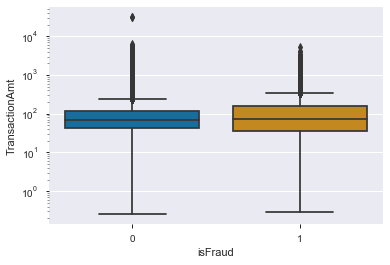

In [60]:
fig, ax = plt.subplots()
ax.set_yscale('log')
sns.boxplot(x = 'isFraud', y = 'TransactionAmt', data = trns_train, palette = 'colorblind', ax = ax)

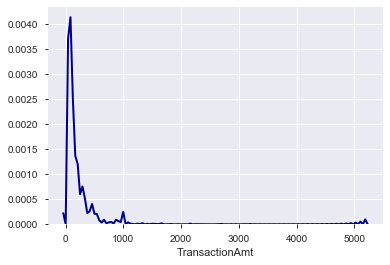

In [45]:
# Density plot

sns.distplot(trns_fraud['TransactionAmt'], hist = False, kde = True,
             color = 'darkblue', 
             kde_kws = {'linewidth': 2})

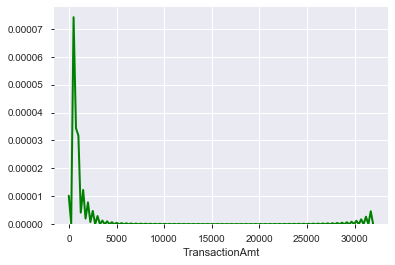

In [44]:
# Density plot

sns.distplot(trns_nonfraud['TransactionAmt'], hist = False, kde = True,
             color = 'green', 
             kde_kws = {'linewidth': 2})

### Number of transactions per transaction amount

**Fraud transactions**

In [68]:
trns_fraud[['TransactionID', 'TransactionAmt']].groupby('TransactionAmt').count().sort_values(by = 'TransactionID', ascending = False)

,TransactionID
TransactionAmt,
117.000,719
59.000,646
150.000,561
100.000,523
49.000,469
200.000,423
226.000,390
300.000,355
50.000,353


**NonFraud transactions**

In [88]:
trns_nonfraud[['TransactionID', 'TransactionAmt']].groupby('TransactionAmt').count().sort_values(by = 'TransactionID', ascending = False)

,TransactionID
TransactionAmt,
59.000,29936
117.000,28214
107.950,23733
57.950,23510
100.000,19839
50.000,16656
49.000,15521
226.000,11314
39.000,10853


### TransactionAmts only appear in Fraud transactions

In [141]:
fraud_amt = set(trns_fraud.TransactionAmt.unique())
nonfraud_amt = set(trns_nonfraud.TransactionAmt.unique())

net_fraud_amt = fraud_amt - nonfraud_amt
net_fraud_amt

{0.292,
 0.35,
 0.424,
 0.467,
 0.484,
 0.583,
 1.45,
 1.59,
 2.231,
 2.89,
 3.508,
 4.01,
 4.63,
 7.055,
 7.456,
 7.825,
 8.337,
 9.26,
 9.481,
 9.937999999999999,
 11.134,
 12.376,
 12.436,
 12.623,
 12.884,
 12.953,
 13.372,
 13.380999999999998,
 13.857999999999999,
 14.110999999999999,
 14.219000000000001,
 14.717,
 14.895999999999999,
 14.908,
 15.187999999999999,
 15.337,
 15.722000000000001,
 16.04,
 16.291,
 17.418,
 18.245,
 18.602999999999998,
 19.175,
 19.567999999999998,
 20.825,
 21.166,
 22.287,
 23.480999999999998,
 23.502,
 26.098000000000003,
 27.883000000000003,
 28.866,
 33.9,
 34.12,
 37.458,
 37.695,
 37.812,
 42.001000000000005,
 45.803000000000004,
 47.188,
 49.663999999999994,
 50.663999999999994,
 51.254,
 51.336000000000006,
 51.538000000000004,
 52.589,
 53.18,
 53.549,
 54.33,
 55.756,
 55.888999999999996,
 58.898,
 59.46,
 60.208,
 60.927,
 61.99,
 62.105,
 65.35300000000001,
 70.193,
 70.384,
 71.96,
 77.592,
 79.988,
 80.298,
 80.396,
 81.14399999999999,


In [ ]:
for index, row in trns_fraud.iterrows():
    

### TransactionAmts only appear in NonFraud transactions

In [89]:
fraud_amt = set(trns_fraud.TransactionAmt.unique())
nonfraud_amt = set(trns_nonfraud.TransactionAmt.unique())

nonfraud_amt - fraud_amt

{2.0,
 3.5,
 4.0,
 6.0,
 6.75,
 9.0,
 10.5,
 12.5,
 9.5,
 15.5,
 21.5,
 17.0,
 27.5,
 33.25,
 36.0,
 43.0,
 48.638000000000005,
 46.5,
 52.5,
 56.0,
 55.5,
 66.0,
 61.5,
 61.0,
 64.529,
 73.471,
 66.5,
 75.887,
 80.721,
 90.993,
 86.0,
 96.97399999999999,
 92.5,
 93.5,
 110.25,
 109.5,
 22.5,
 112.5,
 114.5,
 123.5,
 124.0,
 25.5,
 128.5,
 129.299,
 25.25,
 135.95,
 129.5,
 138.5,
 140.58,
 140.95,
 145.0,
 147.26,
 148.5,
 150.929,
 152.0,
 149.89,
 161.2,
 160.442,
 170.0,
 170.38400000000001,
 169.78,
 173.768,
 179.95,
 175.5,
 175.25,
 185.95,
 187.95,
 186.95,
 190.0,
 192.59,
 190.58,
 189.0,
 190.32299999999998,
 198.5,
 201.95,
 203.37400000000002,
 203.0,
 206.95,
 208.43,
 210.0,
 211.4,
 207.0,
 212.0,
 209.899,
 208.5,
 219.99,
 222.48,
 227.82,
 223.51,
 230.0,
 223.5,
 223.0,
 233.0,
 234.95,
 236.64,
 239.95,
 240.95,
 240.31,
 243.0,
 245.97,
 245.0,
 244.97,
 249.73,
 246.17,
 245.76,
 245.99,
 254.0,
 255.07,
 255.97,
 257.95,
 264.35,
 265.01,
 262.4,
 268.02,
 270.

### Repeated Transactions 

In [215]:
trns_card_dup = trns_card[trns_card.duplicated(["TransactionAmt", "ProductCD", 'card_merged'])]

trns_card_dup.TransactionAmt.value_counts() / trns_card_dup.shape[0]
trns_card_dup.card_merged.value_counts() / trns_card_dup.shape[0]

9500 321.0 150.0 visa 226.0 debit                  0.034640
17188 321.0 150.0 visa 226.0 debit                 0.024669
7919 194.0 150.0 mastercard 166.0 debit            0.021396
15885 545.0 185.0 visa 138.0 debit                 0.018248
12695 490.0 150.0 visa 226.0 debit                 0.016837
                                                     ...   
14972 218.0 150.0 mastercard 203.0 credit          0.000003
9088 520.0 150.0 american express 190.0 credit     0.000003
16990 399.0 150.0 american express 146.0 credit    0.000003
16884 555.0 150.0 visa 226.0 debit                 0.000003
12184 nan nan nan nan nan                          0.000003
Name: card_merged, Length: 7485, dtype: float64

### Repeated Fraud transactions 

In [189]:
trns_card_fraud_dup = trns_card_fraud[trns_card_fraud.duplicated(["TransactionAmt", "ProductCD", 'card_merged'])]
#trns_card_fraud_dup.head()

trns_card_fraud_dup.TransactionAmt.value_counts() / trns_card_fraud_dup.shape[0]
trns_card_fraud_dup.card_merged.value_counts() / trns_card_fraud_dup.shape[0]

9500 321.0 150.0 visa 226.0 debit            0.040832
9633 130.0 185.0 visa 138.0 debit            0.027370
15066 170.0 150.0 mastercard 102.0 credit    0.024032
6019 583.0 150.0 visa 226.0 credit           0.023476
17188 321.0 150.0 visa 226.0 debit           0.020694
                                               ...   
11350 555.0 150.0 visa 226.0 debit           0.000111
1763 555.0 150.0 visa 226.0 debit            0.000111
4610 555.0 150.0 visa 226.0 credit           0.000111
7279 562.0 150.0 mastercard 219.0 credit     0.000111
11059 555.0 150.0 visa 226.0 debit           0.000111
Name: card_merged, Length: 795, dtype: float64

### Repeated NonFraud transactions 

In [188]:
trns_card_nonfraud_dup = trns_card_nonfraud[trns_card_nonfraud.duplicated(["TransactionAmt", "ProductCD", 'card_merged'])]
#trns_card_nonfraud_dup.head()

trns_card_nonfraud_dup.TransactionAmt.value_counts() / trns_card_nonfraud_dup.shape[0]
trns_card_nonfraud_dup.card_merged.value_counts() / trns_card_nonfraud_dup.shape[0]

9500 321.0 150.0 visa 226.0 debit           0.034597
17188 321.0 150.0 visa 226.0 debit          0.024881
7919 194.0 150.0 mastercard 166.0 debit     0.022079
15885 545.0 185.0 visa 138.0 debit          0.017961
12695 490.0 150.0 visa 226.0 debit          0.016943
                                              ...   
12672 555.0 150.0 visa 226.0 debit          0.000003
14583 555.0 150.0 visa 195.0 credit         0.000003
6871 580.0 106.0 visa 226.0 credit          0.000003
15269 555.0 102.0 mastercard 224.0 debit    0.000003
12260 nan nan nan nan nan                   0.000003
Name: card_merged, Length: 7359, dtype: float64

### Check decimal point residue

In [191]:
trns_train.head()

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,dist1,dist2,P_emaildomain,R_emaildomain,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,card_merged
0,2987000,0,86400,68.5,W,13926,NaN,150.0,discover,142.0,credit,315.0,87.0,19.0,NaN,NaN,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,0.0,1.0,1.0,14.0,NaN,13.0,NaN,NaN,NaN,NaN,NaN,NaN,13.0,13.0,NaN,NaN,NaN,0.0,T,T,T,M2,F,T,NaN,NaN,NaN,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,117.0,0.0,0.0,0.0,0.0,0.0,117.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,117.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,117.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13926 nan 150.0 discover 142.0 credit
1,2987001,0,86401,29.0,W,2755,404.0,150.0,mastercard,102.0,credit,325.0,87.0,NaN,NaN,gmail.com,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,M0,T,T,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.

In [192]:
def num_after_point(x):
    s = str(x)
    if not '.' in s:
        return 0
    return len(s) - s.index('.') - 1 

trns_train['TransactionAmt_residue'] = ''

for index, row in trns_train.iterrows():
    r = num_after_point(row['TransactionAmt'])
    if r >= 15:
        trns_train.at[index, 'TransactionAmt_residue'] = 1
    else:
        trns_train.at[index, 'TransactionAmt_residue'] = 0
        

col = trns_train.columns.tolist()
col = col[:4] + col[-1:] + col[4:-1]

trns_train = trns_train[col]
trns_train.head(10)

,TransactionID,isFraud,TransactionDT,TransactionAmt,TransactionAmt_residue,ProductCD,card1,card2,card3,card4,card5,card6,addr1,addr2,dist1,dist2,P_emaildomain,R_emaildomain,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15,M1,M2,M3,M4,M5,M6,M7,M8,M9,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,card_merged
0,2987000,0,86400,68.5,0,W,13926,NaN,150.0,discover,142.0,credit,315.0,87.0,19.0,NaN,NaN,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,2.0,0.0,1.0,1.0,14.0,NaN,13.0,NaN,NaN,NaN,NaN,NaN,NaN,13.0,13.0,NaN,NaN,NaN,0.0,T,T,T,M2,F,T,NaN,NaN,NaN,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,117.0,0.0,0.0,0.0,0.0,0.0,117.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,117.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,117.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13926 nan 150.0 discover 142.0 credit
1,2987001,0,86401,29.0,0,W,2755,404.0,150.0,mastercard,102.0,credit,325.0,87.0,NaN,NaN,gmail.com,NaN,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,M0,T,T,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0

In [198]:
trns_train.TransactionAmt_residue.value_counts() / trns_train.shape[0]

0    0.979119
1    0.020881
Name: TransactionAmt_residue, dtype: float64

In [194]:
trns_fraud = trns_train[trns_train.isFraud == 1]
trns_nonfraud = trns_train[trns_train.isFraud == 0]

In [200]:
trns_fraud.TransactionAmt_residue.value_counts() / trns_fraud.shape[0]

0    0.93665
1    0.06335
Name: TransactionAmt_residue, dtype: float64

In [199]:
trns_nonfraud.TransactionAmt_residue.value_counts() / trns_nonfraud.shape[0]

0    0.980659
1    0.019341
Name: TransactionAmt_residue, dtype: float64

### Profiling

In [201]:
amt = trns_train[['isFraud', 'TransactionAmt', 'TransactionAmt_residue']]
pp.ProfileReport(amt)

### B. dist1